<a href="https://colab.research.google.com/github/Amirrezahmi/Video-Inpainting-and-Voice-Cloning/blob/main/combination%20of%20vi%20%26%20vc/combination_of_VI_%26_VC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Set up your environment
!pip install 'git+https://github.com/facebookresearch/segment-anything.git'
!pip install -q roboflow supervision
!wget -q 'https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth'

  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-3olhb6iw
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-3olhb6iw
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 6fdee8f2727f4506cfbbe553e23b895e27956588
  Preparing metadata (setup.py) ... done
  Created wheel for segment-anything: filename=segment_anything-1.0-py3-none-any.whl size=36588 sha256=cacdd6af95c7c7bc7077246372ba45bcf4875a69a2560fa482bd28ab9649b156
  Stored in directory: /tmp/pip-ephem-wheel-cache-btif3akn/wheels/10/cf/59/9ccb2f0a1bcc81d4fbd0e501680b5d088d690c6cfbc02dc99d
Successfully built segment-anything
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.3/63.3 kB 1.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.2/72.2 kB 8.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 16.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━

In [2]:
!pip install transformers

In [26]:
!pip install pydub

In [39]:
!pip install moviepy

In [3]:
#@title Check GPU
!nvidia-smi

Thu Nov 23 13:43:56 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   45C    P8    10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [4]:
#@title Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
#@title Install dependencies
#@markdown pip may fail to resolve dependencies and raise ERROR, but it can be ignored.
!python -m pip install -U pip wheel
%pip install -U ipython

#@markdown Branch (for development)
BRANCH = "none" #@param {"type": "string"}
if BRANCH == "none":
    %pip install -U so-vits-svc-fork
else:
    %pip install -U git+https://github.com/34j/so-vits-svc-fork.git@{BRANCH}

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 25.6 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 23.1.2
    Uninstalling pip-23.1.2:
      Successfully uninstalled pip-23.1.2
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 808.4/808.4 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 10.0 MB/s eta 0:00:00
  Attempting uninstall: ipython
    Found existing installation: ipython 7.34.0
    Uninstalling ipython-7.34.0:
      Successfully uninstalled ipython-7.34.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires ipython==7.34.0, but you have ipython 8.17.2 which is incompatible.


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.8/61.8 kB 3.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 678.1/678.1 kB 19.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.7/10.7 MB 103.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.0/56.0 kB 5.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 252.0/252.0 kB 24.1 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 100.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.5/93.5 kB 8.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 92.9/92.9 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 86.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 512.7/512.7 kB 39.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━

In [6]:
import torch
import numpy as np
from PIL import Image
import cv2
import os
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator
import matplotlib.pyplot as plt

# Set up SAM model as before
DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
MODEL_TYPE = "vit_h"
CHECKPOINT_PATH = 'sam_vit_h_4b8939.pth'
sam = sam_model_registry[MODEL_TYPE](checkpoint=CHECKPOINT_PATH)
sam.to(device=DEVICE)

mask_generator = SamAutomaticMaskGenerator(sam)

In [7]:
def video_to_frames(video_path, frames_dir):
    video = cv2.VideoCapture(video_path)
    count = 0
    while video.isOpened():
        ret, frame = video.read()
        if not ret:
            break
        cv2.imwrite(frames_dir + "/{:d}.png".format(count), frame)
        count += 1
    video.release()
    #cv2.destroyAllWindows()
    return count

In [8]:
frames_count_1 = video_to_frames('/content/video1.mp4', '/content/file12')
#frames_count_2 = video_to_frames('/content/video2.mp4', '/content/file16')

In [9]:
frames_count_2 = video_to_frames('/content/video2.mp4', '/content/file16')

In [10]:
import os
import shutil

# Define the directories
dir1 = '/content/file12'
dir2 = '/content/file16'

# Get the list of all files in directory 1
files_dir1 = set(os.listdir(dir1))

# Get the list of all files in directory 2
files_dir2 = set(os.listdir(dir2))

# Find the files which are in directory 2 but not in directory 1
files_to_delete = files_dir2 - files_dir1

# Remove these files from directory 2
for file in files_to_delete:
    file_path = os.path.join(dir2, file)
    if os.path.isfile(file_path):
        os.remove(file_path)

In [11]:
import os
import shutil

# Define the directories
dir2 = '/content/file12'
dir1 = '/content/file16'

# Get the list of all files in directory 1
files_dir1 = set(os.listdir(dir1))

# Get the list of all files in directory 2
files_dir2 = set(os.listdir(dir2))

# Find the files which are in directory 2 but not in directory 1
files_to_delete = files_dir2 - files_dir1

# Remove these files from directory 2
for file in files_to_delete:
    file_path = os.path.join(dir2, file)
    if os.path.isfile(file_path):
        os.remove(file_path)

In [12]:
import os

# Specify the folder where your images are located
folder_path = '/content/file12'

# List all files in the folder
files = os.listdir(folder_path)

# Sort the files by their numerical names
sorted_files = sorted(files, key=lambda x: int(x.split('.')[0]))

# Now, sorted_files contains your image filenames in numerical order
print(sorted_files)

['0.png', '1.png', '2.png', '3.png', '4.png', '5.png', '6.png', '7.png', '8.png', '9.png', '10.png', '11.png', '12.png', '13.png', '14.png', '15.png', '16.png', '17.png', '18.png', '19.png', '20.png', '21.png', '22.png', '23.png', '24.png', '25.png', '26.png', '27.png', '28.png', '29.png', '30.png', '31.png', '32.png', '33.png', '34.png', '35.png', '36.png', '37.png', '38.png', '39.png', '40.png', '41.png', '42.png', '43.png', '44.png', '45.png', '46.png', '47.png', '48.png', '49.png', '50.png', '51.png', '52.png', '53.png', '54.png', '55.png', '56.png', '57.png', '58.png', '59.png', '60.png', '61.png', '62.png', '63.png', '64.png', '65.png', '66.png', '67.png', '68.png', '69.png', '70.png', '71.png', '72.png', '73.png', '74.png', '75.png', '76.png', '77.png', '78.png', '79.png', '80.png', '81.png', '82.png', '83.png', '84.png', '85.png', '86.png', '87.png', '88.png', '89.png', '90.png', '91.png', '92.png', '93.png', '94.png', '95.png', '96.png', '97.png', '98.png', '99.png', '100.png'

In [13]:
def display_masks(frames_dir1):
    # List all files in the folders
    files = os.listdir(frames_dir1)
    files.sort(key=lambda x: int(x.split('.')[0]))

    # Load the first image
    image_path1 = os.path.join(frames_dir1, files[0])
    image1 = Image.open(image_path1)
    image_np1 = np.array(image1)

    # Generate masks
    result = mask_generator.generate(image_np1)

    # Calculate the size of the grid based on the number of masks
    rows = int(np.ceil(np.sqrt(len(result))))
    cols = rows

    # Display the masks
    plt.figure(figsize=(20, 20))
    for i, segmentation in enumerate(result):
        plt.subplot(rows, cols, i+1)
        plt.imshow(segmentation['segmentation'], cmap='gray')
        plt.title(f"{i}")
    plt.show()

    return result

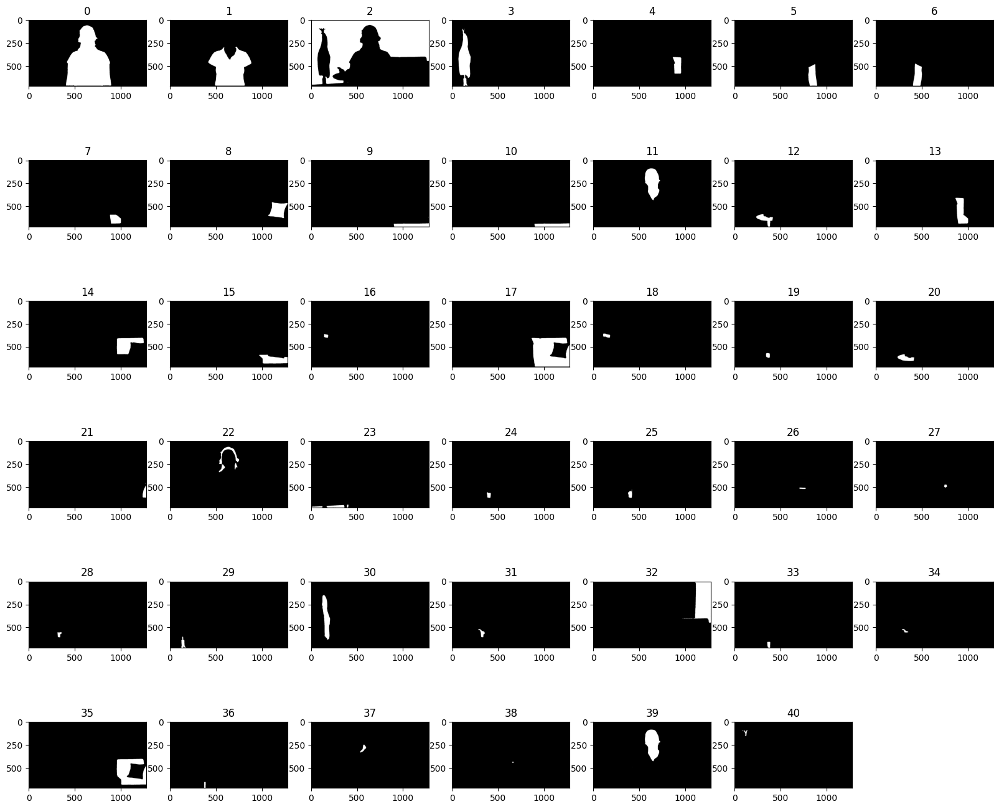

In [14]:
result = display_masks('/content/file12')

In [15]:
chosen_index = int(input("Enter the index of the mask to keep: "))

Enter the index of the mask to keep: 0


In [16]:
def apply_sam_to_frames(frames_dir1, frames_dir2, output_dir, chosen_index):
    # List all files in the folders
    files = os.listdir(frames_dir1)
    files.sort(key=lambda x: int(x.split('.')[0]))

    # Initialize a binary mask with all zeros for the first frame
    first_binary_mask = None

    # Iterate over the sorted files
    for idx, file in enumerate(files):
        # Load the images
        image_path1 = os.path.join(frames_dir1, file)
        image_path2 = os.path.join(frames_dir2, file)
        image1 = Image.open(image_path1)
        image2 = Image.open(image_path2)
        image_np1 = np.array(image1)

        # Generate masks
        result = mask_generator.generate(image_np1)

        # If this is the first frame, set the chosen mask as the first mask
        if first_binary_mask is None:
            first_binary_mask = result[chosen_index]['segmentation']
            previous_binary_mask = first_binary_mask
        else:
            # Find the mask that most closely matches the first mask
            best_iou = 0
            for i, segmentation in enumerate(result):
                # Get the mask
                mask_array = segmentation['segmentation']

                # Calculate the Intersection over Union (IoU) with the first mask
                intersection = np.logical_and(first_binary_mask, mask_array).sum()
                union = np.logical_or(first_binary_mask, mask_array).sum()
                iou = intersection / union

                # If this mask has a higher IoU than the current best, make it the new best
                if iou > best_iou:
                    best_iou = iou
                    previous_binary_mask = mask_array

            # If the IoU is too low, ask the user to choose a new mask
            if best_iou < 0.5:  # Adjust this threshold as needed
                plt.figure(figsize=(20, 20))
                for i, segmentation in enumerate(result):
                    plt.subplot(5, 8, i+1)
                    plt.imshow(segmentation['segmentation'], cmap='gray')
                    plt.title(f"{i}")
                plt.show()

                chosen_index = int(input(f"Enter the index of the mask to keep for frame {idx}: "))
                first_binary_mask = result[chosen_index]['segmentation']
                previous_binary_mask = first_binary_mask

        # Convert the binary mask to uint8
        previous_binary_mask_uint8 = (previous_binary_mask * 255).astype(np.uint8)

        # Resize the mask to match the size of the frame
        previous_binary_mask_resized = cv2.resize(previous_binary_mask_uint8, (image2.width, image2.height), interpolation = cv2.INTER_NEAREST)

        # Resize image1 to match the size of image2
        image1_resized = image1.resize((image2.width, image2.height))

        # Create a transparent image
        transparent_image = Image.new("RGBA", image2.size, (0, 0, 0, 0))

        # Paste the resized image1 onto the transparent image using the resized binary mask
        transparent_image.paste(image1_resized, (0, 0), mask=Image.fromarray(previous_binary_mask_resized))

        # Overlay the transparent image onto the second frame
        image2.paste(transparent_image, (0, 0), transparent_image)

        # Save the output frame
        image2.save(os.path.join(output_dir, file))


In [17]:
apply_sam_to_frames('/content/file12', '/content/file16', '/content/out111', chosen_index)


In [18]:
from os.path import isfile, join
import re

def frames_to_video(inputpath, outputpath, fps):
    frame_array = []
    files = [f for f in os.listdir(inputpath) if isfile(join(inputpath, f))]
    files.sort(key=lambda f: int(re.sub('\D', '', f)))
    for i in range(len(files)):
        filename = join(inputpath, files[i])  # use os.path.join to create the full file path
        img = cv2.imread(filename)
        if img is None:
            print(f"Could not load image: {filename}")
            continue
        height, width, layers = img.shape
        size = (width, height)
        frame_array.append(img)
    out = cv2.VideoWriter(outputpath, cv2.VideoWriter_fourcc(*'DIVX'), fps, size)
    for i in range(len(frame_array)):
        out.write(frame_array[i])
    out.release()

frames_to_video('/content/out111', 'output_video.mp4', 30)

In [19]:
NAME='lether' #Name of your song

We consider you have trained your own model before loading it

In [20]:
#@title Use trained model
#@markdown **Put your .wav file in `so-vits-svc-fork/audio` directory**
from IPython.display import Audio, display
!svc infer -na drive/MyDrive/so-vits-svc-fork/audio/{NAME}.wav -m drive/MyDrive/so-vits-svc-fork/logs/44k/ -c drive/MyDrive/so-vits-svc-fork/logs/44k/config.json

from scipy.io import wavfile

# Read the audio file
#rate, data = wavfile.read(f"drive/MyDrive/so-vits-svc-fork/audio/{NAME}.wav")

# Display the audio file
#display(Audio(data, rate=rate, autoplay=True))


#display(Audio(f"drive/MyDrive/so-vits-svc-fork/audio/{NAME}.out.wav", autoplay=True))

[14:33:32] WARNING  [14:33:32] auto_predict_f0 = False, transpose = 0. If you want   ]8;id=715781;file:///usr/local/lib/python3.10/dist-packages/so_vits_svc_fork/__main__.py\__main__.py]8;;\:]8;id=467692;file:///usr/local/lib/python3.10/dist-packages/so_vits_svc_fork/__main__.py#255\255]8;;\
                    to change the pitch, please set transpose.Generally transpose =                 
                    0 does not work because your voice pitch and target voice pitch                 
                    are different.                                                                  
           INFO     [14:33:32] Since model_path is a directory, use                  ]8;id=583274;file:///usr/local/lib/python3.10/dist-packages/so_vits_svc_fork/__main__.py\__main__.py]8;;\:]8;id=113904;file:///usr/local/lib/python3.10/dist-packages/so_vits_svc_fork/__main__.py#273\273]8;;\
                    drive/MyDrive/so-vits-svc-fork/logs/44k/G_915.pth                          

The result wouldnt be so good because this is a very undertrain model. I finished the training processing so early. by the way we consider you visited the svc fork repository! they told you how to get the vocal and instrumental of your song in 2 .wav files.

In [31]:
from IPython.display import Audio
wn = Audio(f"drive/MyDrive/so-vits-svc-fork/audio/{NAME}.out.wav", autoplay=True)
display(wn)

Now it's time to export the instrumental to vocal

In [29]:
from pydub import AudioSegment

# Load the two audio files
vocal = AudioSegment.from_wav(f"drive/MyDrive/so-vits-svc-fork/audio/{NAME}.out.wav")
instrumental = AudioSegment.from_wav("/content/drive/MyDrive/so-vits-svc-fork/audio/1_Passenger-Let-Her-Go-musicfeed.ir__(Instrumental).wav")

# Overlay the files
merged_song = vocal.overlay(instrumental)

# Export the result
merged_song.export("/content/output_export.wav", format="wav")

<_io.BufferedRandom name='/content/output_export.wav'>

The exported output song is good but I couldnt display it here maybe because it large

In [38]:
from IPython.display import Audio
wn = Audio("/content/output_export.wav", autoplay=True)
display(wn)

In [42]:
from moviepy.editor import VideoFileClip, AudioFileClip

# Load video and audio files
video = VideoFileClip("/content/output_video.mp4")
audio = AudioFileClip("/content/output_export.wav")

# Set the duration of the audio to match the video
audio = audio.set_duration(video.duration)

# Set audio of the video
video = video.set_audio(audio)

# Write the result to a file
video.write_videofile("/content/outputvideo.mp4")

Moviepy - Building video /content/outputvideo.mp4.
MoviePy - Writing audio in outputvideoTEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video /content/outputvideo.mp4



Moviepy - Done !
Moviepy - video ready /content/outputvideo.mp4


The output video is as long as the video s make sure your video is as long as the sound!

In [44]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('/content/outputvideo.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

Done!